In [58]:
import pandas as pd
import numpy as np
from collections import Counter
import matplotlib.pyplot as plt
from sklearn import neighbors
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import statsmodels.api as sm
from scipy import stats
import seaborn as sns
import os

In [12]:
data1 = pd.read_csv("Train.csv")
data2 = pd.read_csv("Test.csv")
data3 = pd.read_csv("Riders.csv")

In [13]:
data1.describe()


,Platform Type,Placement - Day of Month,Placement - Weekday (Mo = 1),Confirmation - Day of Month,Confirmation - Weekday (Mo = 1),Arrival at Pickup - Day of Month,Arrival at Pickup - Weekday (Mo = 1),Pickup - Day of Month,Pickup - Weekday (Mo = 1),Arrival at Destination - Day of Month,Arrival at Destination - Weekday (Mo = 1),Distance (KM),Temperature,Precipitation in millimeters,Pickup Lat,Pickup Long,Destination Lat,Destination Long,Time from Pickup to Arrival
count,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,16835.000000,552.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000
mean,2.752182,15.653696,3.240083,15.653837,3.240225,15.653837,3.240225,15.653837,3.240225,15.653837,3.240225,9.506533,23.258889,7.905797,-1.281470,36.811264,-1.282581,36.811220,1556.920947
std,0.625178,8.798916,1.567295,8.798886,1.567228,8.798886,1.567228,8.798886,1.567228,8.798886,1.567228,5.668963,3.615768,17.089971,0.030507,0.037473,0.034824,0.044721,987.270788
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,11.200000,0.100000,-1.438302,36.653621,-1.430298,36.606594,1.000000
25%,3.000000,8.000000,2.000000,8.000000,2.000000,8.000000,2.000000,8.000000,2.000000,8.000000,2.000000,5.000000,20.600000,1.075000,-1.300921,36.784605,-1.301201,36.785661,882.000000
50%,3.000000,15.000000,3.000000,15.000000,3.000000,15.000000,3.000000,15.000000,3.000000,15.000000,3.000000,8.000000,23.500000,2.900000,-1.279395,36.807040,-1.284382,36.808002,1369.000000
75%,3.000000,23.000000,5.000000,23.000000,5.000000,23.000000,5.000000,23.000000,5.000000,23.000000,5.000000,13.000000,26.000000,4.900000,-1.257147,36.829741,-1.261177,36.829477,2040.000000
max,4.000000,31.000000,7.000000,31.000000,7.000000,31.000000,7.000000,31.000000,7.000000,31.000000,7.000000,49.000000,32.100000,99.100000,-1.147170,36.991046,-1.030225,37.016779,7883.000000


In [14]:
data2.describe()


,Platform Type,Placement - Day of Month,Placement - Weekday (Mo = 1),Confirmation - Day of Month,Confirmation - Weekday (Mo = 1),Arrival at Pickup - Day of Month,Arrival at Pickup - Weekday (Mo = 1),Pickup - Day of Month,Pickup - Weekday (Mo = 1),Distance (KM),Temperature,Precipitation in millimeters,Pickup Lat,Pickup Long,Destination Lat,Destination Long
count,7068.000000,7068.000000,7068.000000,7068.000000,7068.000000,7068.000000,7068.000000,7068.000000,7068.000000,7068.000000,5631.000000,199.000000,7068.000000,7068.000000,7068.000000,7068.000000
mean,2.752122,15.621817,3.249859,15.621817,3.249859,15.621817,3.249859,15.621817,3.249859,9.458970,23.246120,6.651759,-1.282043,36.811148,-1.282255,36.811326
std,0.624000,8.776650,1.580926,8.776650,1.580926,8.776650,1.580926,8.776650,1.580926,5.575689,3.591161,14.085439,0.030044,0.037962,0.034236,0.043507
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,13.200000,0.100000,-1.433512,36.653828,-1.422652,36.639195
25%,3.000000,8.000000,2.000000,8.000000,2.000000,8.000000,2.000000,8.000000,2.000000,5.000000,20.600000,1.100000,-1.301201,36.784605,-1.300921,36.786546
50%,3.000000,15.000000,3.000000,15.000000,3.000000,15.000000,3.000000,15.000000,3.000000,8.000000,23.400000,2.900000,-1.281301,36.807219,-1.283219,36.807927
75%,3.000000,23.000000,5.000000,23.000000,5.000000,23.000000,5.000000,23.000000,5.000000,13.000000,25.900000,4.950000,-1.257274,36.829716,-1.261256,36.828195
max,4.000000,31.000000,7.000000,31.000000,7.000000,31.000000,7.000000,31.000000,7.000000,47.000000,32.100000,99.100000,-1.148352,36.991046,-1.030225,37.018958


In [15]:
len(data1.columns)

29

In [16]:
lien = pd.merge(data1, data3, how='left', left_on='Rider Id', right_on='Rider Id', left_index=True)
lien.columns

Index([u'Order No', u'User Id', u'Vehicle Type', u'Platform Type',
       u'Personal or Business', u'Placement - Day of Month',
       u'Placement - Weekday (Mo = 1)', u'Placement - Time',
       u'Confirmation - Day of Month', u'Confirmation - Weekday (Mo = 1)',
       u'Confirmation - Time', u'Arrival at Pickup - Day of Month',
       u'Arrival at Pickup - Weekday (Mo = 1)', u'Arrival at Pickup - Time',
       u'Pickup - Day of Month', u'Pickup - Weekday (Mo = 1)',
       u'Pickup - Time', u'Arrival at Destination - Day of Month',
       u'Arrival at Destination - Weekday (Mo = 1)',
       u'Arrival at Destination - Time', u'Distance (KM)', u'Temperature',
       u'Precipitation in millimeters', u'Pickup Lat', u'Pickup Long',
       u'Destination Lat', u'Destination Long', u'Rider Id',
       u'Time from Pickup to Arrival', u'No_Of_Orders', u'Age',
       u'Average_Rating', u'No_of_Ratings'],
      dtype='object')

In [17]:
len(data2.columns)

25

In [18]:
set(data1.columns).difference(set(data2.columns))

{'Arrival at Destination - Day of Month',
 'Arrival at Destination - Time',
 'Arrival at Destination - Weekday (Mo = 1)',
 'Time from Pickup to Arrival'}

In [19]:
data1['Time from Pickup to Arrival'].max()

7883

In [20]:
data1.isna().sum()

Order No                                         0
User Id                                          0
Vehicle Type                                     0
Platform Type                                    0
Personal or Business                             0
Placement - Day of Month                         0
Placement - Weekday (Mo = 1)                     0
Placement - Time                                 0
Confirmation - Day of Month                      0
Confirmation - Weekday (Mo = 1)                  0
Confirmation - Time                              0
Arrival at Pickup - Day of Month                 0
Arrival at Pickup - Weekday (Mo = 1)             0
Arrival at Pickup - Time                         0
Pickup - Day of Month                            0
Pickup - Weekday (Mo = 1)                        0
Pickup - Time                                    0
Arrival at Destination - Day of Month            0
Arrival at Destination - Weekday (Mo = 1)        0
Arrival at Destination - Time  

In [21]:
data2.isna().sum()

Order No                                   0
User Id                                    0
Vehicle Type                               0
Platform Type                              0
Personal or Business                       0
Placement - Day of Month                   0
Placement - Weekday (Mo = 1)               0
Placement - Time                           0
Confirmation - Day of Month                0
Confirmation - Weekday (Mo = 1)            0
Confirmation - Time                        0
Arrival at Pickup - Day of Month           0
Arrival at Pickup - Weekday (Mo = 1)       0
Arrival at Pickup - Time                   0
Pickup - Day of Month                      0
Pickup - Weekday (Mo = 1)                  0
Pickup - Time                              0
Distance (KM)                              0
Temperature                             1437
Precipitation in millimeters            6869
Pickup Lat                                 0
Pickup Long                                0
Destinatio






# 1er regression 

In [22]:
train=lien.drop(columns='Precipitation in millimeters',axis = 1)
train=train.drop(columns='Order No',axis = 1)
train=train.drop(columns='User Id',axis = 1)
train=train.drop(columns='Vehicle Type',axis = 1)
train=train.drop(columns='Personal or Business',axis = 1)
train=train.drop(columns='Placement - Time',axis = 1)
train=train.drop(columns='Confirmation - Time',axis = 1)
train=train.drop(columns='Arrival at Pickup - Time',axis = 1)
train=train.drop(columns='Pickup - Time',axis = 1)
train=train.drop(columns='Arrival at Destination - Time',axis = 1)
train=train.drop(columns='Rider Id',axis = 1)
train=train.drop(columns='Platform Type',axis = 1)
train=train.drop(columns='Confirmation - Day of Month',axis = 1)
train=train.drop(columns='Arrival at Pickup - Day of Month',axis = 1)
train=train.drop(columns='Pickup - Day of Month',axis = 1)
train=train.drop(columns='Confirmation - Weekday (Mo = 1)',axis = 1)
train=train.drop(columns='Arrival at Pickup - Weekday (Mo = 1)',axis = 1)
train=train.drop(columns='Pickup - Weekday (Mo = 1)',axis = 1)
train=train.drop(columns='Arrival at Destination - Day of Month',axis = 1)
train=train.drop(columns='Arrival at Destination - Weekday (Mo = 1)',axis = 1)
train.shape

(21201, 13)

In [23]:
train.describe()

,Placement - Day of Month,Placement - Weekday (Mo = 1),Distance (KM),Temperature,Pickup Lat,Pickup Long,Destination Lat,Destination Long,Time from Pickup to Arrival,No_Of_Orders,Age,Average_Rating,No_of_Ratings
count,21201.000000,21201.000000,21201.000000,16835.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000
mean,15.653696,3.240083,9.506533,23.258889,-1.281470,36.811264,-1.282581,36.811220,1556.920947,1692.423706,984.742842,13.882520,341.067119
std,8.798916,1.567295,5.668963,3.615768,0.030507,0.037473,0.034824,0.044721,987.270788,1574.308302,646.652835,0.916071,402.867746
min,1.000000,1.000000,1.000000,11.200000,-1.438302,36.653621,-1.430298,36.606594,1.000000,2.000000,96.000000,0.000000,0.000000
25%,8.000000,2.000000,5.000000,20.600000,-1.300921,36.784605,-1.301201,36.785661,882.000000,557.000000,495.000000,13.600000,61.000000
50%,15.000000,3.000000,8.000000,23.500000,-1.279395,36.807040,-1.284382,36.808002,1369.000000,1212.000000,872.000000,14.000000,161.000000
75%,23.000000,5.000000,13.000000,26.000000,-1.257147,36.829741,-1.261177,36.829477,2040.000000,2311.000000,1236.000000,14.300000,495.000000
max,31.000000,7.000000,49.000000,32.100000,-1.147170,36.991046,-1.030225,37.016779,7883.000000,9756.000000,3764.000000,15.200000,2298.000000


In [24]:
train=train.fillna(23.26)

In [25]:
train=train.drop(columns='No_Of_Orders',axis = 1) 
train=train.drop(columns='Age',axis = 1)
train=train.drop(columns='No_of_Ratings',axis = 1)
train.shape

(21201, 10)

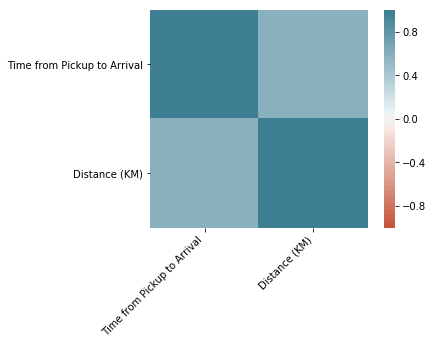

In [26]:
corr=train[["Time from Pickup to Arrival","Distance (KM)"]].corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

In [27]:
train.describe()

,Placement - Day of Month,Placement - Weekday (Mo = 1),Distance (KM),Temperature,Pickup Lat,Pickup Long,Destination Lat,Destination Long,Time from Pickup to Arrival,Average_Rating
count,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000,21201.000000
mean,15.653696,3.240083,9.506533,23.259118,-1.281470,36.811264,-1.282581,36.811220,1556.920947,13.882520
std,8.798916,1.567295,5.668963,3.222006,0.030507,0.037473,0.034824,0.044721,987.270788,0.916071
min,1.000000,1.000000,1.000000,11.200000,-1.438302,36.653621,-1.430298,36.606594,1.000000,0.000000
25%,8.000000,2.000000,5.000000,21.400000,-1.300921,36.784605,-1.301201,36.785661,882.000000,13.600000
50%,15.000000,3.000000,8.000000,23.260000,-1.279395,36.807040,-1.284382,36.808002,1369.000000,14.000000
75%,23.000000,5.000000,13.000000,25.300000,-1.257147,36.829741,-1.261177,36.829477,2040.000000,14.300000
max,31.000000,7.000000,49.000000,32.100000,-1.147170,36.991046,-1.030225,37.016779,7883.000000,15.200000


In [28]:
train.corr()

,Placement - Day of Month,Placement - Weekday (Mo = 1),Distance (KM),Temperature,Pickup Lat,Pickup Long,Destination Lat,Destination Long,Time from Pickup to Arrival,Average_Rating
Placement - Day of Month,1.000000,0.026148,-0.007585,0.011610,-0.004929,-0.005453,0.007541,0.002077,-0.014710,0.012790
Placement - Weekday (Mo = 1),0.026148,1.000000,0.003582,0.027704,-0.000918,0.011008,-0.004299,-0.000875,0.009693,-0.006834
Distance (KM),-0.007585,0.003582,1.000000,-0.002091,-0.124338,0.178537,-0.079366,0.135397,0.580608,-0.008200
Temperature,0.011610,0.027704,-0.002091,1.000000,0.015949,0.007822,0.009237,0.023422,0.005769,-0.024769
Pickup Lat,-0.004929,-0.000918,-0.124338,0.015949,1.000000,-0.147629,0.114975,0.051399,-0.053823,0.043610
Pickup Long,-0.005453,0.011008,0.178537,0.007822,-0.147629,1.000000,0.014992,0.082803,0.060285,-0.001885
Destination Lat,0.007541,-0.004299,-0.079366,0.009237,0.114975,0.014992,1.000000,0.046767,-0.061872,0.030488
Destination Long,0.002077,-0.000875,0.135397,0.023422,0.051399,0.082803,0.046767,1.000000,0.070425,0.002017
Time from Pickup to Arrival,-0.014710,0.009693,0.580608,0.005769,-0.053823,0.060285,-0.061872,0.070425,1.000000,-0.042559
Average_Rating,0.012790,-0.006834,-0.008200,-0.024769,0.043610,-0.001885,0.030488,0.002017,-0.042559,1.000000


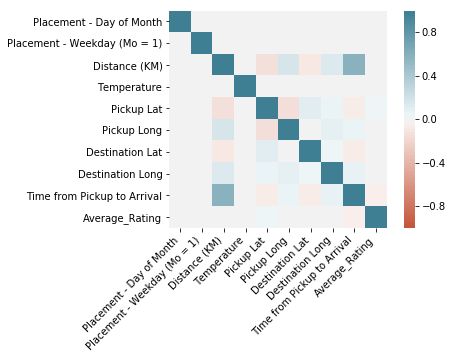

In [29]:
corr=train.corr()
ax = sns.heatmap(
    corr, 
    vmin=-1, vmax=1, center=0,
    cmap=sns.diverging_palette(20, 220, n=200),
    square=True
)
ax.set_xticklabels(
    ax.get_xticklabels(),
    rotation=45,
    horizontalalignment='right'
);

In [30]:
x = train.drop(columns='Time from Pickup to Arrival',axis = 1)
y = train['Time from Pickup to Arrival']

# REGRESSION multiples

In [31]:
X_train, X_test, y_train, y_test = train_test_split(x,y, test_size=0.8)

In [32]:
reg = LinearRegression()
reg.fit(X_train, y_train)

print("coefficient: ",reg.coef_)
print("intercept: ",reg.intercept_)
print("score_train:",reg.score(X_train,y_train))


X2 = sm.add_constant(X_train)
est = sm.OLS(y_train, X2)
est2 = est.fit()
print(est2.summary())


('coefficient: ', array([-8.49703898e-01, -9.60154116e+00,  1.04243256e+02,  4.49430056e-01,
       -9.10607473e+01, -1.02150608e+03, -2.25742854e+02, -3.77975187e+02,
       -4.58587271e+01]))
('intercept: ', 52369.677593329616)
('score_train:', 0.343357870583169)
                                 OLS Regression Results                                
Dep. Variable:     Time from Pickup to Arrival   R-squared:                       0.343
Model:                                     OLS   Adj. R-squared:                  0.342
Method:                          Least Squares   F-statistic:                     245.8
Date:                         Sun, 03 Nov 2019   Prob (F-statistic):               0.00
Time:                                 13:22:04   Log-Likelihood:                -34371.
No. Observations:                         4240   AIC:                         6.876e+04
Df Residuals:                             4230   BIC:                         6.883e+04
Df Model:                     

In [33]:
y_predi=reg.predict(X_test)
comparaison=pd.DataFrame()
comparaison['exact'] = y_test
comparaison['predit'] = y_predi
print(comparaison.head())

exact       predit
70    2741   670.164842
96     594  1010.644796
798   3232  1300.644099
655   1261  2139.800397
448      3  1765.699190


In [34]:
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_test, y_predi))

In [35]:
print("rmse:", rmse(y_test, y_predi))

('rmse:', 802.4582045900503)


# clustermap

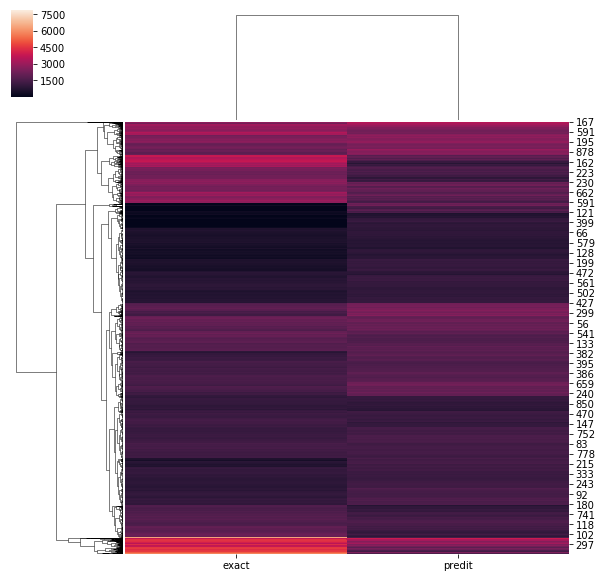

In [36]:
sns.clustermap(comparaison)

# Parcelle de densité

/home/moussa/user/local/anaconda/lib/python2.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


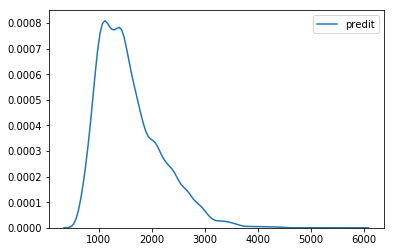

In [37]:
sns.kdeplot(comparaison.predit)

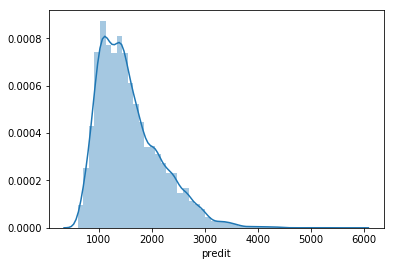

In [38]:
sns.distplot(comparaison.predit)

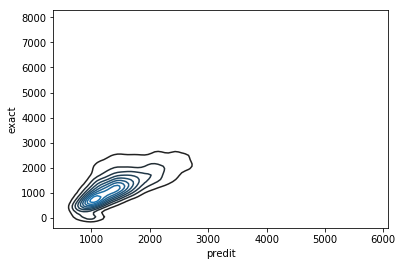

In [39]:
sns.kdeplot(comparaison.predit, comparaison.exact)

# Nuage de points

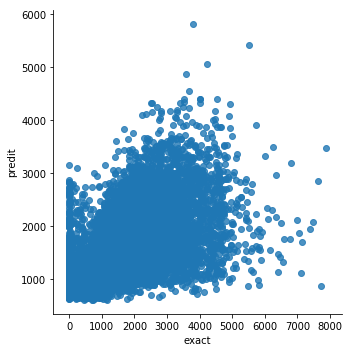

In [40]:
sns.lmplot('exact', 'predit', data=comparaison, fit_reg=False)


# Boîte à moustaches

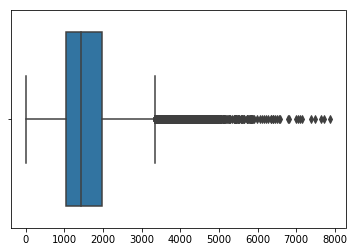

In [41]:
sns.boxplot([comparaison.predit, comparaison.exact])

# L'histogramme

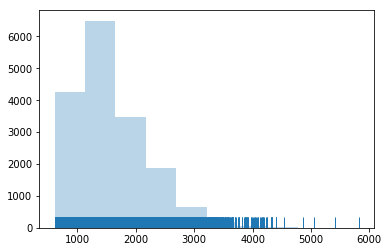

In [42]:
plt.hist(comparaison.predit, alpha=.3)
sns.rugplot(comparaison.predit);

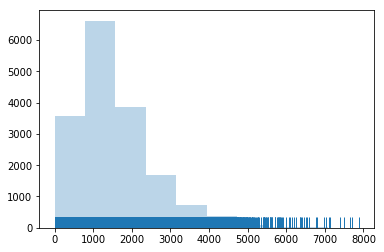

In [43]:
plt.hist(comparaison.exact, alpha=.3)
sns.rugplot(comparaison.exact);

# 1er KNN

In [44]:
 #afficher la performance en fonction de k
errors = []
for k in range(2,15):
    knn = neighbors.KNeighborsClassifier(k)
    errors.append(100*(1 - knn.fit(X_train, y_train).score(X_train, y_train)))
plt.plot(range(2,15), errors, 'o-')
plt.show()

In [0]:
#Comme on peut le voir, le k-NN le plus performant est celui pour lequel k = 2. On connaît

In [0]:
knn=KNeighborsClassifier(n_neighbors=2)
knn.fit(X_train, y_train)

In [0]:
print("score:",1-knn.score(X_train,y_train))


In [0]:
# On récupère les prédictions sur les données test
predicted = knn.predict(X_test)
predicted 

In [0]:
comparaison=pd.DataFrame()
comparaison['exact'] = y_test
comparaison['predit'] = predicted
print(comparaison.head())

In [56]:
print("rmse:", rmse(y_test, predicted))

rmse: 800.9804987557601


### Model training and submission creation

In [59]:
def write_submission_file(prediction, filename,
                          path_to_sample=os.path.join('SampleSubmission.csv')):
    submission = pd.read_csv(path_to_sample, index_col='Order_No')
    
    submission['Time from Pickup to Arrival'] = prediction
    submission.to_csv(filename)

In [66]:
len(predicted)

16961

In [64]:
write_submission_file(prediction=predicted, filename='submissions.csv')